# Project Data Analysis & Visualization Menggunakan Global Weather Dataset

## Columns descriptions:

- country: Country of the weather data
- location_name: Name of the location (city)
- latitude: Latitude coordinate of the location
- longitude: Longitude coordinate of the location
- timezone: Timezone of the location
- last_updated_epoch: Unix timestamp of the last data update
- last_updated: Local time of the last data update
- temperature_celsius: Temperature in degrees Celsius
- temperature_fahrenheit: Temperature in degrees Fahrenheit
- condition_text: Weather condition description
- wind_mph: Wind speed in miles per hour
- wind_kph: Wind speed in kilometers per hour
- wind_degree: Wind direction in degrees
- wind_direction: Wind direction as a 16-point compass
- pressure_mb: Pressure in millibars
- pressure_in: Pressure in inches
- precip_mm: Precipitation amount in millimeters
- precip_in: Precipitation amount in inches
- humidity: Humidity as a percentage
- cloud: Cloud cover as a percentage
- feels_like_celsius: Feels-like temperature in Celsius
- feels_like_fahrenheit: Feels-like temperature in Fahrenheit
- visibility_km: Visibility in kilometers
- visibility_miles: Visibility in miles
- uv_index: UV Index
- gust_mph: Wind gust in miles per hour
- gust_kph: Wind gust in kilometers per hour
- air_quality_Carbon_Monoxide: Air quality measurement: Carbon Monoxide
- air_quality_Ozone: Air quality measurement: Ozone
- air_quality_Nitrogen_dioxide: Air quality measurement: Nitrogen Dioxide
- air_quality_Sulphur_dioxide: Air quality measurement: Sulphur Dioxide
- air_quality_PM2.5: Air quality measurement: PM2.5
- air_quality_PM10: Air quality measurement: PM10
- air_quality_us-epa-index: Air quality measurement: US EPA Index
- air_quality_gb-defra-index: Air quality measurement: GB DEFRA Index
- sunrise: Local time of sunrise
- sunset: Local time of sunset
- moonrise: Local time of moonrise
- moonset: Local time of moonset
- moon_phase: Current moon phase
- moon_illumination: Moon illumination percentage

# 1. Basic Exploratory Data Analysis (EDA)

## 1.1. Setup & Load 

In [2]:
    # Import Libraries
    import pandas as pd
    import numpy as np
    import matplotlib.pyplot as plt
    import seaborn as sns
    import plotly.express as px
    import plotly.graph_objects as go

1. pandas: For table-based data manipulation and analysis (DataFrame), such as reading datasets, cleaning data, performing aggregation, and transforming columns.
2. numpy: For efficient numerical computation, especially array and matrix operations, mathematical functions, and basic statistics often used before further analysis.
3. matplotlib.pyplot: The core plotting module in Python for creating static 2D visualizations, such as line charts, bar charts, histograms, scatter plots, and more.
4. seaborn: A high-level visualization library built on top of Matplotlib, providing cleaner and easier-to-use statistical graphics (such as heatmaps, boxplots, violin plots).
5. plotly.express: A concise API for quickly creating interactive visualizations, well-suited for data exploration because it supports zoom, hover, and filtering automatically.
6. plotly.graph_objects: The advanced version of Plotly for building more complex and detailed interactive visualizations, allowing full customization of every chart element.

In [3]:
# File path for dataset (CSV)    
FILE_PATH = r"C:\DTSenseAIML\DtSense_Weather_Projects Data Visualization & Final Projects\Global_Weather.csv"

# Read dataset
df = pd.read_csv(FILE_PATH)

# Dataset overview
print(">> Shape (rows, cols):", df.shape)
print(">> Columns:", list(df.columns))

print()

# Display the first 5 rows of the dataset
print(">> First 5 rows of the dataset:")
print(df.head())

>> Shape (rows, cols): (72680, 41)
>> Columns: ['country', 'location_name', 'latitude', 'longitude', 'timezone', 'last_updated_epoch', 'last_updated', 'temperature_celsius', 'temperature_fahrenheit', 'condition_text', 'wind_mph', 'wind_kph', 'wind_degree', 'wind_direction', 'pressure_mb', 'pressure_in', 'precip_mm', 'precip_in', 'humidity', 'cloud', 'feels_like_celsius', 'feels_like_fahrenheit', 'visibility_km', 'visibility_miles', 'uv_index', 'gust_mph', 'gust_kph', 'air_quality_Carbon_Monoxide', 'air_quality_Ozone', 'air_quality_Nitrogen_dioxide', 'air_quality_Sulphur_dioxide', 'air_quality_PM2.5', 'air_quality_PM10', 'air_quality_us-epa-index', 'air_quality_gb-defra-index', 'sunrise', 'sunset', 'moonrise', 'moonset', 'moon_phase', 'moon_illumination']

>> First 5 rows of the dataset:
       country     location_name  latitude  longitude        timezone  \
0  Afghanistan             Kabul     34.52      69.18      Asia/Kabul   
1      Albania            Tirana     41.33      19.82   

This dataset have 72,680 rows and 41 features/variables, include:
- Geographic information: country, location_name, latitude, longitude, timezone.
- Date/time information: last_updated_epoch (UNIX timestamp), last_updated (human-readable time).
- Weather conditions: temperature_celsius, temperature_fahrenheit, condition_text, wind_mph, wind_kph, pressure_mb, precip_mm, etc.
- Air quality indicators: Levels of gases (Carbon_Monoxide, Ozone, etc.), particulates (PM2.5, PM10), and indices (us-epa-index, gb-defra-index).
- Astronomical data: sunrise, sunset, moonrise, moonset, moon_phase, moon_illumination.

# 2. Data Cleaning

## 2.1. Column Categorization 

In [4]:
# Create a list of numeric columns (for summary statistics and visualizations).
# Use SI units (Celsius, kph, mm, km) to keep everything consistent worldwide.
numeric_cols_si = [
    "temperature_celsius", "humidity", "pressure_mb",
    "wind_kph", "wind_degree", "gust_kph",
    "precip_mm", "cloud", "visibility_km", "uv_index",
    "latitude", "longitude", "moon_illumination"
]

# Convert values to numeric (turn non-numeric/blank into NaN).
for c in numeric_cols_si:
    if c in df.columns:
        df[c] = pd.to_numeric(df[c], errors="coerce")

# Choose categorical columns (non-numeric values used for grouping or labeling).
cat_cols = ["country", "location_name", "timezone", "wind_direction", "moon_phase"]
for c in cat_cols:
    if c in df.columns:
        df[c] = df[c].astype("category")

# Convert time columns to datetime.
time_cols = ["last_updated", "sunrise", "sunset", "moonrise", "moonset"]
for c in time_cols:
    if c in df.columns:
        df[c] = pd.to_datetime(df[c], errors="coerce")

# Imperial unit columns.
imperial_cols = [
    "temperature_fahrenheit", "wind_mph", "pressure_in", "precip_in",
    "visibility_miles", "feels_like_fahrenheit", "gust_mph"
]
present_imperials = [c for c in imperial_cols if c in df.columns]
print(">> Imperial columns present (not used in main visuals):", present_imperials)

# "feels_like_*" columns are calculated values (extra info, not main variables).
derived_cols = [c for c in df.columns if "feels_like" in c]
print(">> Derived 'feels_like' columns (informational only):", derived_cols)


>> Imperial columns present (not used in main visuals): ['temperature_fahrenheit', 'wind_mph', 'pressure_in', 'precip_in', 'visibility_miles', 'feels_like_fahrenheit', 'gust_mph']
>> Derived 'feels_like' columns (informational only): ['feels_like_celsius', 'feels_like_fahrenheit']


C:\Users\User\AppData\Local\Temp\ipykernel_20184\1560821837.py:25: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[c] = pd.to_datetime(df[c], errors="coerce")
C:\Users\User\AppData\Local\Temp\ipykernel_20184\1560821837.py:25: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[c] = pd.to_datetime(df[c], errors="coerce")
C:\Users\User\AppData\Local\Temp\ipykernel_20184\1560821837.py:25: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[c] = pd.to_datetime(df[c], errors="coerce")
C:\Users\User\AppData\Local\Temp\ipykernel_20184\1560821837.py:25: UserWarning: Could not infer form

Here, we separate the columns into numeric (can be calculated and plotted as continuous data) and non-numeric (categorical or time-based).

The reason for this step is to clearly distinguish which variables are suitable for histograms, scatterplots, or boxplots, and which ones are better used for categorical or temporal analysis. By doing so, the choice of visualization methods later will be more accurate and effective.

## 2.2. Column Categorization Results

In [5]:
# Data types of each column

print("\n>> Data types of each column:")
print(df.dtypes)

# Separate numeric and non-numeric columns
numeric_present = df.select_dtypes(include=["number"]).columns.tolist()
non_numeric_present = [c for c in df.columns if c not in numeric_present]

# Show numeric columns
print("\n>> Numeric columns:", len(numeric_present))
print(numeric_present)

# Show non-numeric columns
print("\n>> Non-numeric columns:", len(non_numeric_present))
print(non_numeric_present)



>> Data types of each column:
country                               category
location_name                         category
latitude                               float64
longitude                              float64
timezone                              category
last_updated_epoch                       int64
last_updated                    datetime64[ns]
temperature_celsius                    float64
temperature_fahrenheit                 float64
condition_text                          object
wind_mph                               float64
wind_kph                               float64
wind_degree                              int64
wind_direction                        category
pressure_mb                            float64
pressure_in                            float64
precip_mm                              float64
precip_in                              float64
humidity                                 int64
cloud                                    int64
feels_like_celsius           

After the data is loaded, we make sure each column has the correct data type:
- Numeric variables: temperature, humidity, pressure, wind.
- Categorical variables: country or wind direction.
- Time variables (datetime): last_updated, sunrise, sunset.

The data types must be correct to avoid mistakes in analysis and visualization. In addition, we also standardize:
- International System of Units (SI): Celsius, kilometers per hour, millibars, millimeters, kilometers.
- Imperial columns: Fahrenheit, mph, inches, miles (remain in the dataset but are not used in the main visuals, to avoid duplicate meanings).
- feels_like_* columns: derived values from temperature, humidity, and wind (marked as informational only).

## 2.3. Missing Value Analysis & Categorization

In [6]:
# Count and percentage of missing values per column
missing_cnt = df.isna().sum().sort_values(ascending=False)
missing_pct = (df.isna().mean() * 100).sort_values(ascending=False)
missing_report = pd.DataFrame({"missing_count": missing_cnt, "missing_pct": missing_pct})

# Show top 15 columns with most missing values
print(">> Missing values (top 15 column):")
display(missing_report.head(15))

# Categorize columns by percentage of missing values
lt5 = missing_report[missing_report["missing_pct"] < 5].index.tolist()
btw_5_20 = missing_report[(missing_report["missing_pct"] >= 5) & (missing_report["missing_pct"] <= 20)].index.tolist()
gt20 = missing_report[missing_report["missing_pct"] > 20].index.tolist()

# Show categorized columns based on missing values
print("\n>> <5% missing (drop rows when needed):", lt5)
print(">> 5–20% missing (light median impute for aggregate visuals):", btw_5_20)
print(">> >20% missing (avoid in main visuals):", gt20)


>> Missing values (top 15 column):


,missing_count,missing_pct
moonrise,2522,3.470006
moonset,2326,3.200330
country,0,0.000000
air_quality_Sulphur_dioxide,0,0.000000
visibility_miles,0,0.000000
uv_index,0,0.000000
gust_mph,0,0.000000
gust_kph,0,0.000000
air_quality_Carbon_Monoxide,0,0.000000
air_quality_Ozone,0,0.000000



>> <5% missing (drop rows when needed): ['moonrise', 'moonset', 'country', 'air_quality_Sulphur_dioxide', 'visibility_miles', 'uv_index', 'gust_mph', 'gust_kph', 'air_quality_Carbon_Monoxide', 'air_quality_Ozone', 'air_quality_Nitrogen_dioxide', 'air_quality_PM2.5', 'feels_like_fahrenheit', 'air_quality_PM10', 'air_quality_us-epa-index', 'air_quality_gb-defra-index', 'sunrise', 'sunset', 'moon_phase', 'visibility_km', 'feels_like_celsius', 'location_name', 'cloud', 'latitude', 'longitude', 'timezone', 'last_updated_epoch', 'last_updated', 'temperature_celsius', 'temperature_fahrenheit', 'condition_text', 'wind_mph', 'wind_kph', 'wind_degree', 'wind_direction', 'pressure_mb', 'pressure_in', 'precip_mm', 'precip_in', 'humidity', 'moon_illumination']
>> 5–20% missing (light median impute for aggregate visuals): []
>> >20% missing (avoid in main visuals): []


We calculated the number and percentage of missing values for each column, then categorized them according to the following rules:
- <5% missing → Rows with missing values can be safely dropped if necessary.
- 5–20% missing → Can be filled with light imputation (e.g., median), mainly for aggregate visualizations, with caution.
- >20% missing → Should be excluded from main visuals, as too many missing values may distort the analysis.

We need to categorized because the proportion of missing values directly affects data reliability. Small amounts (<5%) have little impact and can be dropped. Moderate amounts (5–20%) may bias results if ignored, so light imputation keeps analyses stable. Large amounts (>20%) reduce credibility too much, so excluding those columns prevents misleading interpretations.

From the output, the dataset has very few missing values overall. Only two columns have missing data (All other columns have 0% missing values):    
- moonrise (3.47%)
- moonset (3.20%)

Based on the categorization, all columns can be safely used without the need for imputation or exclusion from the main visuals.

## 2.4. Duplicate Detection & Data Validation

In [7]:
# Exact duplicates
dup_count = df.duplicated().sum()
print(">> Exact duplicate rows:", dup_count)

# Validate coordinates (if columns exist)
invalid_geo_idx = set()
if "latitude" in df.columns:
    bad_lat = ~df["latitude"].between(-90, 90, inclusive="both")
    print(">> Invalid latitude rows:", int(bad_lat.sum()))
    invalid_geo_idx |= set(df.index[bad_lat])
if "longitude" in df.columns:
    bad_lon = ~df["longitude"].between(-180, 180, inclusive="both")
    print(">> Invalid longitude rows:", int(bad_lon.sum()))
    invalid_geo_idx |= set(df.index[bad_lon])

# 3) Validate wind_degree (0 ≤ degree < 360)
if "wind_degree" in df.columns:
    bad_wdeg = ~df["wind_degree"].between(0, 360, inclusive="left")
    print(">> Invalid wind_degree rows:", int(bad_wdeg.sum()))
else:
    bad_wdeg = pd.Series(False, index=df.index)

# Simple validation sunrise < sunset (best-effort; depends on datetime format)
if {"sunrise", "sunset"}.issubset(df.columns):
    both = df["sunrise"].notna() & df["sunset"].notna()
    bad_daylight = both & (df["sunrise"] >= df["sunset"])
    print(">> Rows with sunrise >= sunset (potential parsing issues):", int(bad_daylight.sum()))
else:
    bad_daylight = pd.Series(False, index=df.index)

>> Exact duplicate rows: 0
>> Invalid latitude rows: 0
>> Invalid longitude rows: 0
>> Invalid wind_degree rows: 273
>> Rows with sunrise >= sunset (potential parsing issues): 1


Rules:
- Exact duplicates: can be dropped to avoid bias.
- Invalid coordinates: drop only when plotting maps (these rows cannot be mapped).
- Invalid wind_degree: exclude from charts that require wind direction/degree.
- Sunrise >= Sunset: mark as potential errors; do not use for day/night analysis.

From the output we can conclude that the dataset is generally clean with no duplicates or invalid coordinates. However, it has 273 rows with invalid wind degrees and a significant issue in sunrise/sunset time formatting (30k+ rows). These anomalies need to be addressed or excluded to ensure accurate analysis and visualization.

# 3. Statistical Aggregation

## 3.1. Outlier Detection Using IQR Method 

In [8]:
# Select numeric columns (that exist in the dataset)
num_cols_present = [c for c in numeric_cols_si if c in df.columns]
stats = df[num_cols_present].describe(percentiles=[0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]).T
stats["iqr"] = stats["75%"] - stats["25%"]
print(">> Statistik numerik ringkas (SI):")
display(stats)

# Function to create an outlier mask using the IQR method
def iqr_outlier_mask(series: pd.Series, k: float = 1.5):
    q1, q3 = series.quantile(0.25), series.quantile(0.75)
    iqr = q3 - q1
    if pd.isna(q1) or pd.isna(q3):
        return pd.Series(False, index=series.index)
    lower, upper = q1 - k * iqr, q3 + k * iqr
    return (series < lower) | (series > upper)

# Count outliers for each numeric column
outlier_counts = {}
for col in num_cols_present:
    s = df[col].dropna()
    mask = iqr_outlier_mask(s, k=1.5)
    outlier_counts[col] = int(mask.sum())

# Create outlier report and sort by count
outlier_report = pd.DataFrame({"outlier_count_iqr": outlier_counts}).sort_values("outlier_count_iqr", ascending=False)
print("\n>> Outlier counts (IQR method, k=1.5):")
display(outlier_report)

>> Statistik numerik ringkas (SI):


,count,mean,std,min,1%,5%,25%,50%,75%,95%,99%,max,iqr
temperature_celsius,72680.0,22.178485,9.389486,-24.9,-2.70,3.9000,16.8000,24.5000,28.30,34.40,40.1000,49.20,11.5000
humidity,72680.0,63.637369,24.317889,2.0,9.00,18.0000,46.0000,69.0000,83.00,96.00,100.0000,100.00,37.0000
pressure_mb,72680.0,1014.064241,12.561074,947.0,996.00,1004.0000,1010.0000,1013.0000,1017.00,1027.00,1033.0000,3006.00,7.0000
wind_kph,72680.0,13.326626,13.921876,3.6,3.60,3.6000,6.5000,11.2000,18.40,29.90,38.2000,2963.20,11.9000
wind_degree,72680.0,168.654554,103.626180,1.0,5.00,15.0000,80.0000,160.0000,256.00,340.00,357.0000,360.00,176.0000
gust_kph,72680.0,18.891186,15.849198,3.6,4.00,5.4000,10.7000,16.2000,25.10,40.60,53.7000,2970.40,14.4000
precip_mm,72680.0,0.139704,0.596025,0.0,0.00,0.0000,0.0000,0.0000,0.03,0.81,2.1500,42.24,0.0300
cloud,72680.0,39.892102,33.854933,0.0,0.00,0.0000,2.0000,31.0000,75.00,100.00,100.0000,100.00,73.0000
visibility_km,72680.0,9.614337,2.532462,0.0,1.10,5.0000,10.0000,10.0000,10.00,10.00,24.0000,32.00,0.0000
uv_index,72680.0,3.983459,3.627636,0.0,0.00,0.0000,0.7000,3.3000,7.00,10.40,13.8000,16.30,6.3000



>> Outlier counts (IQR method, k=1.5):


,outlier_count_iqr
visibility_km,14015
precip_mm,13761
longitude,5590
pressure_mb,4544
gust_kph,1748
temperature_celsius,1390
wind_kph,1060
humidity,0
wind_degree,0
cloud,0


The statistical summary shows that the dataset is generally reasonable, with average conditions around 22 °C for temperature, 64 percent humidity, and normal pressure near 1014 mb. Winds are moderate overall, but some extreme values stand out, like the maximum wind and gust speeds reach nearly 2963 kph, which is physically impossible, and the pressure column includes an unrealistic peak of 3006 mb, both of which likely reflect errors in measurement or parsing. Visibility also appears capped at 10 km, with a maximum of 32 km, suggesting a reporting or sensor limit rather than true variation.

The IQR outlier analysis confirms these issues by flagging large numbers of values in visibility and precipitation. This is expected because visibility is capped and rainfall is both zero-heavy and highly skewed. Longitude also generates many flagged values, though this reflects the natural global spread of locations rather than actual errors. In contrast, variables such as humidity, cloud cover, and UV index behave within expected ranges and do not show problematic outliers. 

We produced summary statistics for numeric variables including mean, median, percentiles (1%, 5%, 25%, 75%, 95%, 99%), and the interquartile range (IQR). In addition, outliers were detected using the IQR method, which marks values lying outside Q1–1.5×IQR or Q3+1.5×IQR. These outliers were not removed, only counted. This choice is important because summary statistics provide an initial view of distributions and help set the scale for visualizations such as histograms. Outliers are often genuine in weather data (for example, storms or heat waves), so they should be shown in visuals like boxplots to reflect extreme conditions. For aggregation across countries or cities, medians will be prioritized, since they are more robust to the influence of extreme values.

## 3.2. Entity Summary (Countries & Locations)

In [9]:
# Count the number of unique countries and unique locations
n_countries = df["country"].nunique() if "country" in df.columns else None
n_locations = df["location_name"].nunique() if "location_name" in df.columns else None
print(">> Unique countries:", n_countries, "| Unique locations:", n_locations)


# If both 'country' and 'location_name' exist, count locations per country
if {"country", "location_name"}.issubset(df.columns):
    country_loc_counts = (df.groupby("country", dropna=False)["location_name"]
                            .nunique()
                            .sort_values(ascending=False))
    print("\n>> Banyaknya lokasi per negara (top 15):")
    display(country_loc_counts.head(15))


>> Unique countries: 210 | Unique locations: 248

>> Banyaknya lokasi per negara (top 15):


C:\Users\User\AppData\Local\Temp\ipykernel_20184\1626021250.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  country_loc_counts = (df.groupby("country", dropna=False)["location_name"]


country
Paraguay                        4
Belgium                         4
Indonesia                       4
Palau                           4
Cameroon                        4
Vietnam                         3
Myanmar                         3
Jamaica                         3
Bulgaria                        3
USA United States of America    3
Maldives                        3
Iceland                         3
Russia                          3
United States of America        3
China                           2
Name: location_name, dtype: int64

The dataset covers a wide scope with 210 unique countries and 248 unique locations. This shows that the data is globally distributed, providing broad geographic coverage.

When looking at the distribution of locations per country, most countries are represented by only a few locations. The top group in the dataset, such as Paraguay, Belgium, Indonesia, Palau, and Cameroon, each have four unique locations, while several others including Vietnam, Myanmar, Jamaica, Bulgaria, and the United States appear with three. This pattern suggests that the dataset is relatively balanced and does not overly concentrate on a single country, but instead spreads observations across many different regions.

Such information is useful for designing visualizations, for example by ranking countries with the highest number of locations or focusing on the top 10 countries to keep comparisons clear and easy to interpret.

# 4. EDA & Data Visualization

## 4.1. Histogram (Log-scale) – Rainfall Data (precip_mm)

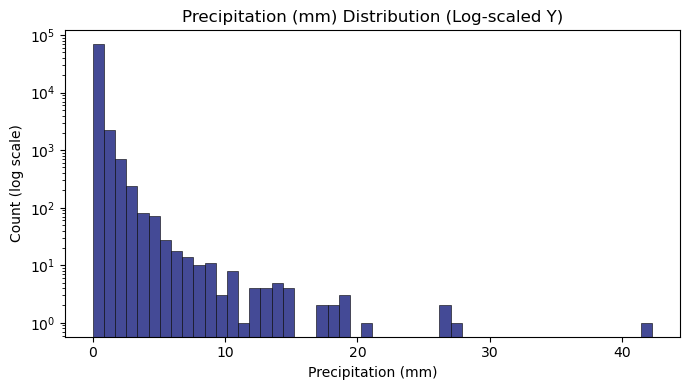

In [10]:
# Basic Histogram of Precipitation (mm) with log-scaled Y-axis
vals = df["precip_mm"].dropna()

plt.figure(figsize=(7,4))
plt.hist(
    vals, 
    bins=50, 
    edgecolor="black", 
    linewidth=0.4, 
    color="#444a96"   
)
plt.yscale("log")
plt.title("Precipitation (mm) Distribution (Log-scaled Y)")
plt.xlabel("Precipitation (mm)")
plt.ylabel("Count (log scale)")
plt.tight_layout()
plt.show()

1. **Reason**:
A histogram with a log-scaled Y-axis is used because the precip_mm distribution is highly unbalanced, most values are zero or very small, while only a few are large, so the right tail remains visible without the initial bars dominating.
2. **Shape of the Distribution**:
It is strongly right-skewed with many outliers on the higher-value side.
3. **Dominant Value Group**:
Values between 0–2 mm dominate (light rain or almost no rain); events above 10 mm are much rarer but still present, reaching up to around 40 mm.
4. **Implications for Data Understanding**:
“Dry or drizzly” weather is the typical condition, while moderate to heavy rainfall is rare but still important to analyze. The log scale helps reveal the complete pattern (common versus extreme) without losing details of the overall distribution.
5. **Key insights**:
    - Light rain (≤2 mm) is the most common condition.
    - Moderate to heavy rain (>10 mm) is rare but still recorded in the dataset.
    - This visualization highlights the importance of using a log scale for meteorological data such as rainfall, so that extreme events can still be analyzed without losing the overall distribution detail.

## 4.2. Histogram Decoration (Log-scale)  – Rainfall Data (precip_mm)

In [11]:
precip = df[["precip_mm"]].copy()
precip = precip[pd.notnull(precip["precip_mm"])]

zero_count = int((precip["precip_mm"] == 0).sum())
precip_pos = precip[precip["precip_mm"] > 0]  # log-y cannot display count=0

# Interactive histogram with Plotly
fig = px.histogram(
    precip_pos,
    x="precip_mm",
    nbins=50,                 # initial default, can be changed via buttons
    log_y=True,               # Y-axis log scale for skewed distribution
    template="plotly_white",
    opacity=0.9,
    marginal="box",           # display a small boxplot on top
    title="Precipitation (mm) — Interactive Distribution (Log Y)"
)
    
# Trace & hover decoration 
fig.update_traces(
    marker_line_color="rgba(0,0,0,0.6)",
    marker_line_width=0.5,
    hovertemplate="<b>Bin</b>: %{x}<br><b>Count</b>: %{y}<extra></extra>"
)

# Layout: axis labels, grid, and bar gaps
fig.update_layout(
    xaxis_title="Precipitation (mm)",
    yaxis_title="Count (log scale)",
    bargap=0.05,
    hovermode="x unified"
)

# Range slider for exploring the distribution tail
fig.update_xaxes(rangeslider=dict(visible=True), type="linear")

# Buttons for switch Y-axis (log/linear) & number of bins (30/50/80) 
fig.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            direction="right",
            x=1, xanchor="right",
            y=1.18, yanchor="top",
            buttons=[
                dict(label="Log Y",    method="relayout", args=[{"yaxis.type": "log"}]),
                dict(label="Linear Y", method="relayout", args=[{"yaxis.type": "linear"}]),
                dict(label="Bins: 30", method="restyle",  args=[{"nbinsx": [30]}]),
                dict(label="Bins: 50", method="restyle",  args=[{"nbinsx": [50]}]),
                dict(label="Bins: 80", method="restyle",  args=[{"nbinsx": [80]}]),
            ]
        )
    ]
)

# For zero values (not shown in log scale)
if zero_count > 0:
    fig.add_annotation(
        text=f"{zero_count:,} observations with 0 mm not shown on log scale",
        xref="paper", yref="paper", x=0.5, y=1.08, showarrow=False,
        font=dict(size=11, color="gray")
    )

fig.show()


Using Plotly for a decorated histogram is more helpful for exploration because it is interactive and informative. It provides hover tooltips with bin values and counts, a range slider to examine the tail of the distribution, buttons to switch the Y-axis scale between log and linear as well as to adjust the number of bins (30, 50, or 80) without rerunning the code, and a marginal boxplot that immediately shows a summary with median and IQR. This decorated histogram also automatically includes a special note for zero values that do not appear on a log scale, preventing misinterpretation by the reader. In comparison, a basic histogram without decoration only produces a static diagram which is sufficient for quick documentation but lacks interactivity, on-the-fly adjustments, and concise contextual information within a single figure, making the decorated version more suitable for flexible and communicative analysis and presentation.

**Key insights**:
-  Light rain (≤2 mm) is the most common condition.
- Moderate to heavy rain (>10 mm) is rare but still recorded in the dataset.
- This visualization highlights the importance of using a log scale for meteorological data such as rainfall, so that extreme events can still be analyzed without losing the overall   distribution detail.

## Boxplot – Temperature Day vs Night (temperature_celsius)

C:\Users\User\AppData\Local\Temp\ipykernel_20184\1496363537.py:18: MatplotlibDeprecationWarning:

The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.



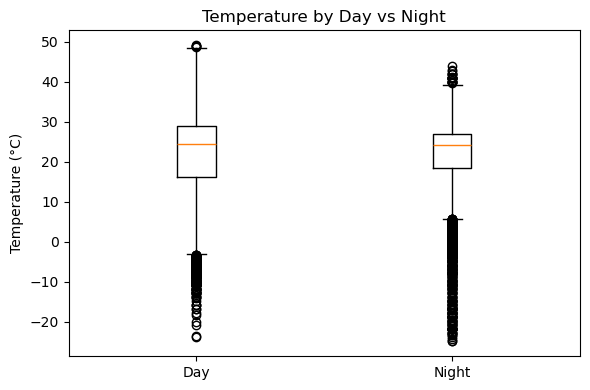

In [12]:
need = ["temperature_celsius", "last_updated", "sunrise", "sunset"]
avail = [c for c in need if c in df.columns]
dtemp = df[avail].dropna(subset=["temperature_celsius", "last_updated"]).copy()

def classify_day_night(row):
    su, ss, lu = row.get("sunrise"), row.get("sunset"), row.get("last_updated")
    if pd.notna(su) and pd.notna(ss) and (su < ss):
        return "Day" if (lu.time() >= su.time()) and (lu.time() < ss.time()) else "Night"
    return np.nan

dtemp["day_night"] = dtemp.apply(classify_day_night, axis=1)
dtemp = dtemp.dropna(subset=["day_night"])

groups = [g["temperature_celsius"].dropna().values for _, g in dtemp.groupby("day_night")]
labels = [name for name, _ in dtemp.groupby("day_night")]

plt.figure(figsize=(6,4))
plt.boxplot(groups, labels=labels, showfliers=True)
plt.title("Temperature by Day vs Night")
plt.ylabel("Temperature (°C)")
plt.tight_layout()
plt.show()


1. **Reason**:
A boxplot was chosen because it can summarize the distribution of daytime and nighttime temperatures through the median, interquartile range (IQR), and outliers. This visualization is very effective for comparing two categories.
2. **Difference in Median**:
The median temperature during the day is higher than at night, which aligns with the general pattern that temperatures are hotter when the sun is up compared to nighttime.
3. **Range of Variation**:
Both day and night temperatures show a wide range of values, reflecting global climate variation across locations. This indicates that although the medians differ, the distributions still overlap.
4. **Extreme Outliers**:
Many outliers appear in both categories, such as very low temperatures (below −20 °C) or very high ones (approaching 50 °C). These outliers are not data errors but rather extreme weather conditions in certain locations.
5. **Key Insight**:
    - Daytime temperatures tend to be higher than nighttime temperatures, but geographic variation causes the two distributions to overlap. 
    - The presence of extreme outliers highlights the occurrence of extreme climate phenomena during both day and night.

## Scatter Plot (Map) – Temperature Data (latitude, longitude, temperature_celsius)

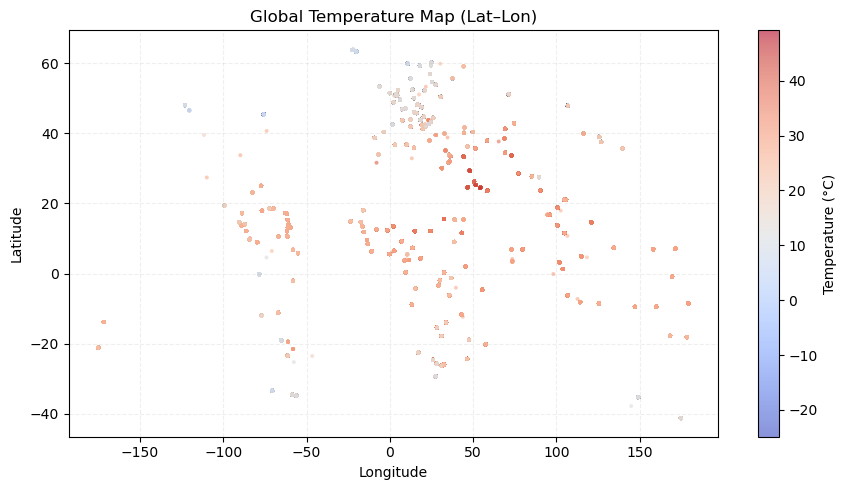

In [13]:
data = df[["latitude", "longitude", "temperature_celsius"]].dropna()
plt.figure(figsize=(9,5))
sc = plt.scatter(
    data["longitude"], data["latitude"],
    c=data["temperature_celsius"], cmap="coolwarm",
    s=8, alpha=0.6, edgecolors="none"
)
plt.colorbar(sc, label="Temperature (°C)")
plt.title("Global Temperature Map (Lat–Lon)")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(alpha=0.2, linestyle="--")
plt.tight_layout()
plt.show()


1. **Reason**:
A scatter plot on latitude and longitude coordinates was chosen to directly visualize the spatial pattern of temperature. With continuous coloring based on temperature (°C), it becomes possible to connect temperature variations with geographic positions on the world map.
2. **Relationship Pattern (linear, non-linear, or no pattern)**:
A non-linear pattern based on latitude is visible, where temperature decreases as the distance from the equator increases (greater |latitude|). There is no clear linear relationship with longitude. The pattern is more like hot–cold latitude belts rather than a straight line.
3. **Geographic Pattern**:
Locations near the equator (low latitudes) are dominated by red colors, which indicate higher temperatures. Conversely, points in mid to high latitudes (above 40°) often appear blue or pale, representing lower temperatures. This reflects the global climate pattern where tropical regions are warmer while subtropical and temperate regions are cooler.
4. **Extreme Outliers**:
Some deep red points with temperatures above 40°C indicate very hot regions such as desert areas. Meanwhile, blue points with temperatures below −10°C represent extremely cold locations such as high-latitude regions.
5. **Data Density**:
The points are not evenly distributed across the world. There is a denser concentration in Asia and Europe, while oceans and some regions of Africa and the Americas are relatively sparse. This highlights the uneven distribution of observation stations.
6. **Key Insight**:
    - This visualization reinforces the fundamental climate pattern of Earth, with hot tropics and cold poles. 
    - Temperature distribution is strongly influenced by latitude, with extreme hot and cold phenomena appearing in specific locations. 
    - The uneven density of points also reminds us that analysis must take into account the geographic bias of the data.

## Scatter Plot Decoration (Map) – Temperature Data (latitude, longitude, temperature_celsius)

In [14]:
# --- Data subset: only rows with valid lat/lon & temperature
d = df[["latitude","longitude","temperature_celsius","location_name","country","humidity","uv_index"]].dropna()

# Optional: clamp color range so extreme outliers don't dominate the colors
tmin, tmax = np.nanpercentile(d["temperature_celsius"], [1, 99])

fig = px.scatter_mapbox(
    d,
    lat="latitude",
    lon="longitude",
    color="temperature_celsius",
    color_continuous_scale="RdBu_r",   # blue=cold, red=hot
    range_color=(tmin, tmax),
    hover_name="location_name",
    hover_data={"country": True, "humidity": True, "uv_index": True,
                "latitude": False, "longitude": False},
    zoom=1.2,
    height=520,
)

# Nice, readable tiles with no token required
fig.update_layout(
    mapbox_style="open-street-map",
    mapbox=dict(center=dict(lat=0, lon=15), zoom=1.2),
    margin=dict(l=10, r=10, t=50, b=10),
    title="Global Temperature – Scatter Map (Zoom & Pan Enabled)",
    coloraxis_colorbar=dict(title="Temp (°C)")
)

# Improve marker aesthetics & hover
fig.update_traces(
    marker=dict(size=7, opacity=0.8),
    hovertemplate=(
        "<b>%{hovertext}</b><br>"   # location_name
        "Country: %{customdata[0]}<br>"
        "Temp: %{marker.color:.1f} °C<br>"
        "Humidity: %{customdata[1]} %<br>"
        "UV Index: %{customdata[2]:.1f}<extra></extra>"
    )
)

# --- Region zoom presets (dropdown) ---
region_presets = {
    "World":   dict(center=dict(lat=  0, lon=  15), zoom=1.2),
    "Europe":  dict(center=dict(lat= 50, lon=  10), zoom=3.2),
    "SE Asia": dict(center=dict(lat=  5, lon= 105), zoom=3.2),
    "Americas":dict(center=dict(lat= 15, lon= -80), zoom=2.8),
}

buttons = [
    dict(
        label=name,
        method="relayout",
        args=[{"mapbox.center": preset["center"], "mapbox.zoom": preset["zoom"]}]
    )
    for name, preset in region_presets.items()
]

fig.update_layout(
    updatemenus=[dict(type="dropdown", x=0.01, y=0.99, xanchor="left", yanchor="top", buttons=buttons)]
)

fig.show()


C:\Users\User\AppData\Local\Temp\ipykernel_20184\2965718579.py:7: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



A basic scatter plot of temperature only shows points based on latitude and longitude coordinates, so the global pattern is visible but without clear geographic context. In contrast, a scatter mapbox places the points on top of a world map with interactive zoom and pan, allowing temperature patterns to be explored both globally and regionally. The added map background, along with zoom and pan features, restores the missing geographic context of the basic scatter. With the map as a reference, temperature patterns can be linked to specific regions such as continents, coastlines, deserts, or mountain ranges. This makes the visualization more intuitive, concrete, and flexible than the basic version.

**Key Insights**:
- tropical regions are hotter while higher latitudes are colder. 
- Contrast between hot and humid Southeast Asia and the cooler climate of Europe.

## Hexbin Plot – Temperature vs Humidity (temperature_celsius, humidity)

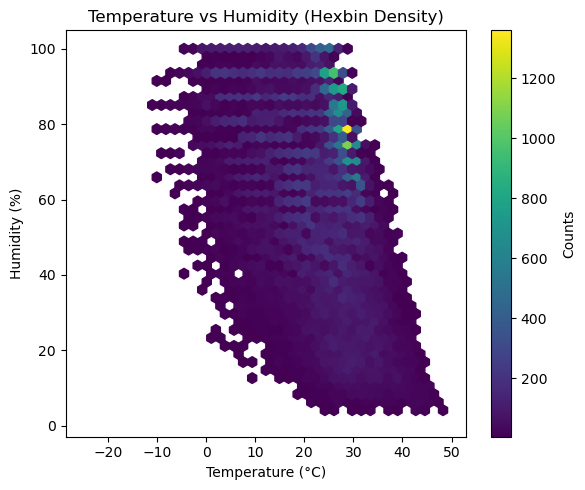

In [15]:
xy = df[["temperature_celsius", "humidity"]].dropna()
plt.figure(figsize=(6,5))
hb = plt.hexbin(xy["temperature_celsius"], xy["humidity"], gridsize=40, cmap="viridis", mincnt=5)
plt.colorbar(hb, label="Counts")
plt.title("Temperature vs Humidity (Hexbin Density)")
plt.xlabel("Temperature (°C)")
plt.ylabel("Humidity (%)")
plt.tight_layout()
plt.show()


1. **Reason**:
A hexbin plot was chosen because the dataset is very large and a regular scatter plot would cause overplotting. With hexbin, the density of points can be visualized using color gradients, making the relationship between temperature and humidity easier to read.
2. **Relationship Pattern**:
In general, there is a negative tendency between temperature and humidity. As temperature increases, relative humidity decreases. This is consistent with the physical properties of air, since warmer air can hold more water vapor which causes relative humidity to drop.
3. **Data Concentration**:
The highest concentration of points, shown in green to yellow, lies in the temperature range of around 20 to 30°C with high humidity between 70 and 90 percent. This indicates that most weather observations in the dataset are in warm conditions with high relative humidity, which is typical of tropical and subtropical climates.
4. **Extreme Variation**:
There are also areas with low temperatures below 0°C that still show high humidity, as well as areas with very high temperatures above 40°C that tend to have low humidity. These points represent extreme conditions such as snowy cold weather or hot dry desert climates.
5. **Key Insight**:
    - Hexbin plot confirms that the general pattern of temperature and humidity in the dataset tends to be negative, with the largest concentration in warm and humid conditions. 
    - The visualization effectively highlights the dominant pattern while also revealing the presence of extreme phenomena across different climate conditions.

## Bar Chart (Horizontal) – Mean Temperature / Country (country, temperature_celsius)

C:\Users\User\AppData\Local\Temp\ipykernel_20184\2807696363.py:13: FutureWarning:

The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.

C:\Users\User\AppData\Local\Temp\ipykernel_20184\2807696363.py:16: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



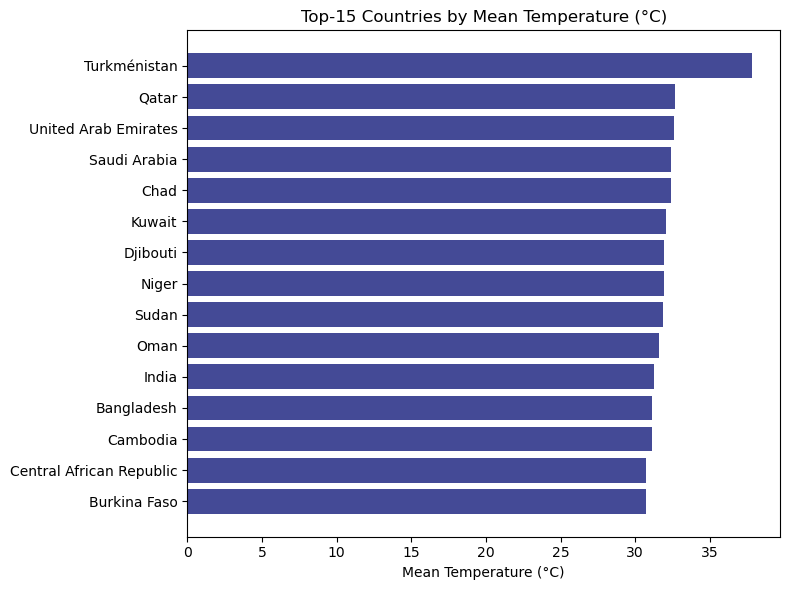

In [16]:
import matplotlib.pyplot as plt

# Normalize country names 
country_mapping = {
    "Saudi Arabien": "Saudi Arabia",
    "Marrocos": "Morocco",
    "Турция": "Turkey",
    "Inde": "India",
    # add more mappings if found
}

subset = df[["country", "temperature_celsius"]].dropna().copy()
subset["country"] = subset["country"].replace(country_mapping)

# Calculate mean temperature per country 
mean = subset.groupby("country")["temperature_celsius"].mean().sort_values(ascending=False)

# === Top-15 ===
top15_mean = mean.head(15)[::-1]   # reverse for horizontal bar (bottom=highest)

# === Plot with specified color ===
plt.figure(figsize=(8,6))
plt.barh(top15_mean.index.astype(str), top15_mean.values, color="#444a96")
plt.title("Top-15 Countries by Mean Temperature (°C)")
plt.xlabel("Mean Temperature (°C)")
plt.tight_layout()
plt.show()


1. **Reason**:
A horizontal bar chart was chosen to clearly show the comparison of average temperatures across countries. Using the mean helps provide a general picture of temperature conditions, although it is more sensitive to extreme values compared to the median.
2. **Highest and Lowest Categories (Top-15)**:
    - Highest: Turkmenistan with an average close to 38°C, making it the hottest country by average temperature.
    - Middle: Qatar, United Arab Emirates, and Saudi Arabia also occupy the top positions, consistent with the extremely hot desert climate.
    - Lowest within the Top-15: Burkina Faso, Central African Republic, and Cambodia with averages around 31°C.
3. **Value Range and Differences Between Categories**:
The average temperatures of countries in this list range from 31°C to 38°C, with a gap of about 7°C. The Gulf countries (Qatar, UAE, Saudi Arabia, Kuwait) have very close values, reflecting a uniformly hot climate in the region.
4. **Key Insight**:
    - This visualization confirm the dominance of desert and tropical regions as the countries with the highest average temperatures in the world. 
    - The mean-based visualization shows a consistent pattern that countries in arid and tropical areas tend to rank at the top in terms of average temperature.
    - Unexpected Finding is the appearance of countries like Cambodia and Bangladesh in the Top-15 is somewhat surprising, as they are humid tropical regions rather than arid deserts. This shows that high average temperatures are not limited to dry climates but can also occur in tropical regions with intense heat.

## Bar Chart Decoration (Horizontal) – Mean Temperature / Country (country, temperature_celsius)

In [ ]:
# Normalize country names 
country_mapping = {
    "Saudi Arabien": "Saudi Arabia",
    "Marrocos": "Morocco",
    "Турция": "Turkey",
    "Inde": "India",
    # add more mappings if found
}

subset = df[["country", "temperature_celsius"]].dropna().copy()
subset["country"] = subset["country"].replace(country_mapping)

# Mean temperature per country (descending) 
mean_series = subset.groupby("country")["temperature_celsius"].mean().sort_values(ascending=False)

# Take Top-15 in DESC order (rank1 at index 0) 
top15_desc = mean_series.head(15)

# helper: lighten a hex color by blending with white
def lighten(hex_color, factor=0.4):
    hex_color = hex_color.lstrip("#")
    r, g, b = int(hex_color[0:2], 16), int(hex_color[2:4], 16), int(hex_color[4:6], 16)
    r = int(r + (255 - r) * factor)
    g = int(g + (255 - g) * factor)
    b = int(b + (255 - b) * factor)
    return f"#{r:02x}{g:02x}{b:02x}"

base = "#444a96"           # Top-1
light = lighten(base, 0.35)   # Top-2..5
lighter = lighten(base, 0.65) # Top-6..15

# assign colors for 15 bars (in DESC order)
colors_desc = []
for i in range(len(top15_desc)):
    if i == 0:
        colors_desc.append(base)
    elif i < 5:
        colors_desc.append(light)
    else:
        colors_desc.append(lighter)

# Plot horizontally from bottom to top: reverse both data & colors
top15_plot = top15_desc.iloc[::-1]
colors_plot = colors_desc[::-1]

# Build interactive bar chart 
fig = go.Figure(
    go.Bar(
        x=top15_plot.values, 
        y=top15_plot.index.astype(str),
        orientation="h",
        marker=dict(color=colors_plot, line=dict(color="rgba(0,0,0,0.3)", width=0.5)),
        text=[f"{v:.1f}°C" for v in top15_plot.values],
        textposition="outside",
        hovertemplate="<b>%{y}</b><br>Mean Temp: %{x:.2f} °C<extra></extra>",
    )
)

fig.update_layout(
    title="Top-15 Countries by Mean Temperature (°C)",
    xaxis_title="Mean Temperature (°C)",
    yaxis_title="",
    template="plotly_white",
    margin=dict(l=10, r=30, t=60, b=40),
)

fig.show()


C:\Users\User\AppData\Local\Temp\ipykernel_20184\2261301815.py:11: FutureWarning:

The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.

C:\Users\User\AppData\Local\Temp\ipykernel_20184\2261301815.py:14: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Additional elements such as tiered colors, value labels (°C) at the end of each bar, and interactive features (hover and zoom) make comparisons much clearer. The color tiers highlight the hierarchy instantly, the labels remove the need to estimate bar length, and interactivity allows the audience to explore details without altering the chart. Together, these features make differences across categories easier to see and understand.

The most important finding is that desert and tropical countries dominate the list of highest average temperatures globally. Turkmenistan ranks first with nearly 38°C, while Gulf countries cluster closely at 32–33°C, showing the uniformity of hot climates in that region. This visualization confirms that global temperature patterns are strongly shaped by geography, with dry and tropical areas consistently at the top.

## Bar Chart – Median Temperature / Country (country, temperature_celsius)

C:\Users\User\AppData\Local\Temp\ipykernel_20184\4076163175.py:11: FutureWarning:

The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.

C:\Users\User\AppData\Local\Temp\ipykernel_20184\4076163175.py:15: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



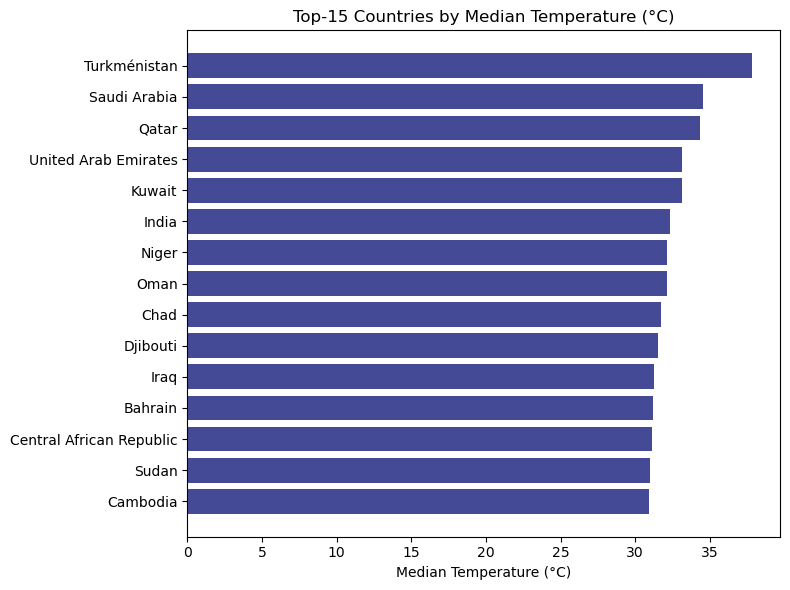

In [26]:
# Normalize country names
country_mapping = {
    "Saudi Arabien": "Saudi Arabia",
    "Marrocos": "Morocco",
    "Турция": "Turkey",
    "Inde": "India",
    # add more mappings if found
}

subset = df[["country", "temperature_celsius"]].dropna().copy()
subset["country"] = subset["country"].replace(country_mapping)

# Calculate median temperature per country 
med = (
    subset.groupby("country")["temperature_celsius"]
    .median()
    .sort_values(ascending=False)
)

# Top-15 ranking 
top15 = med.head(15)[::-1] 

plt.figure(figsize=(8,6))
plt.barh(top15.index.astype(str), top15.values, color="#444a96")
plt.title("Top-15 Countries by Median Temperature (°C)")
plt.xlabel("Median Temperature (°C)")
plt.tight_layout()
plt.show()

1. **Reason**:
A horizontal bar chart is most appropriate for comparing categories such as countries. The use of the median rather than the mean makes the ranking more robust against extreme temperature outliers such as heatwaves. Before aggregation, country names were normalized to avoid duplicate entities.
2. **Dominance of Hot and Dry Climates**:
The top of the list is dominated by countries in West and Central Asia and North or Sub-Saharan Africa (Turkmenistan, Saudi Arabia, Qatar, UAE, Kuwait, Oman, Chad, Djibouti, Sudan). These regions are characterized by arid or semi-arid climates, which consistently produce high typical (median) temperatures.
3. **Value Range and Ranking Distance**:
The median values range from the low 30s °C up to nearly 40°C, with Turkmenistan appearing as the highest in this sample. The distance between rankings is relatively tight among the top group (Gulf countries), reflecting the uniformity of hot conditions in this region.
4. **Reliability of Aggregation**:
The median was chosen so that the ranking would not be distorted by local extreme events.
5. **Key Insight**:
The median temperature ranking confirms that countries with dry or subtropical climates have the highest typical temperatures globally.

## Bar Chart – Median Humidity / Country (country, humidity)

C:\Users\User\AppData\Local\Temp\ipykernel_20184\3620831520.py:4: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\User\AppData\Local\Temp\ipykernel_20184\3620831520.py:8: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



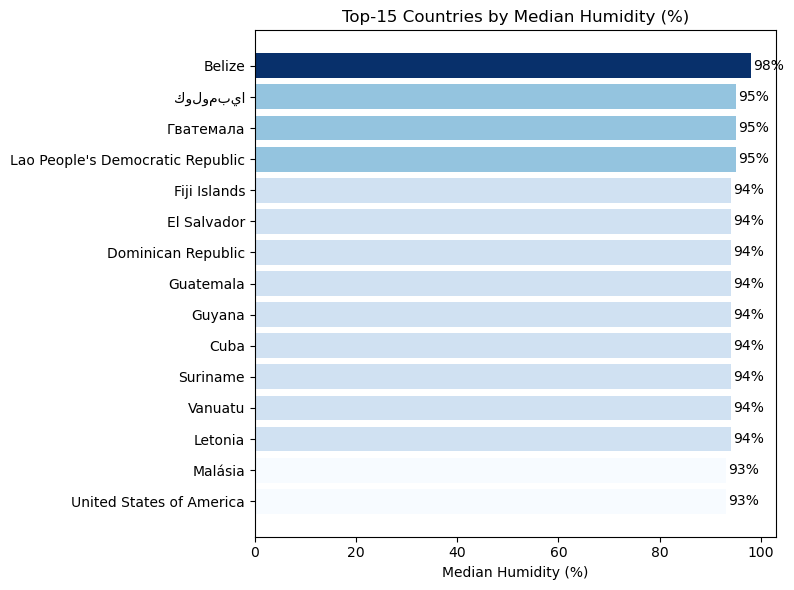

In [28]:
from matplotlib import cm, colors

subset = df[["country", "humidity"]].dropna()
med = subset.groupby("country")["humidity"].median().sort_values(ascending=False)
top15 = med.head(15)[::-1]

norm = colors.Normalize(vmin=top15.min(), vmax=top15.max())
cmap = cm.get_cmap("Blues")
colors_ = cmap(norm(top15.values))

plt.figure(figsize=(8,6))
bars = plt.barh(top15.index.astype(str), top15.values, color=colors_)
plt.title("Top-15 Countries by Median Humidity (%)")
plt.xlabel("Median Humidity (%)")
for b, v in zip(bars, top15.values):
    plt.text(b.get_width()+0.5, b.get_y()+b.get_height()/2, f"{v:.0f}%", va="center")
plt.tight_layout()
plt.show()


1. **Comparison**: A horizontal bar chart with decoration (colormap and percentage labels at the end of the bars) was chosen to make category comparisons easier and to speed up value reading. The use of the median ensures that the results remain robust against extreme humidity outliers.
2. **Dominance of High Humidity**:
Tropical and coastal countries dominate the top rankings. The median humidity values are very high (95–98%), indicating consistently humid environmental conditions almost all the time.
3. **Value Density**:
Most of the countries in the Top 15 cluster within the 93–95% range, showing that the differences between rankings are relatively small. This suggests a uniformity of typical humidity in tropical countries included in the list.
4. **Readability and Communication**:
The gradient coloring helps highlight the top rankings, while numerical percentage labels reduce the need to estimate bar lengths. This combination improves clarity without adding visual complexity.
5. **Key Insight**:
Tropical and coastal countries show very high and relatively uniform typical humidity (around 93–98%). The decorated visualization makes the rankings and magnitude of values clearer.

## Pie Chart – Day vs Night (last_updated, sunrise, sunset)

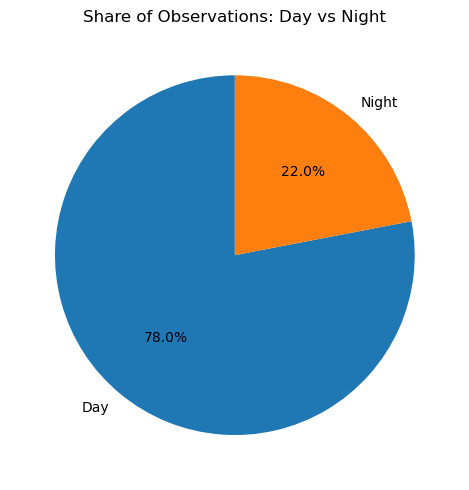

In [20]:
cols = ["last_updated", "sunrise", "sunset"]
avail = [c for c in cols if c in df.columns]
d = df[avail].dropna()

def classify_day_night(row):
    su, ss, lu = row["sunrise"], row["sunset"], row["last_updated"]
    if pd.notna(su) and pd.notna(ss) and (su < ss):
        return "Day" if (lu.time() >= su.time()) and (lu.time() < ss.time()) else "Night"
    return np.nan

d["day_night"] = d.apply(classify_day_night, axis=1)
counts = d["day_night"].value_counts(dropna=True)

plt.figure(figsize=(5,5))
plt.pie(counts.values, labels=counts.index, autopct="%.1f%%", startangle=90)
plt.title("Share of Observations: Day vs Night")
plt.tight_layout()
plt.show()


1. **Reason**:
A pie chart was chosen because the categories being compared are only two, Day and Night, which makes it a simple, clear, and quick way to represent proportions.
2. **Proportion Distribution**:
The visualization shows that 78 percent of the observations were recorded during the day and only 22 percent at night. This considerable difference indicates that the dataset is dominated by daytime observations.
3. **Data Implication**:
The imbalance in distribution may be caused by weather sensors or data collection being more active or more easily accessible during the day compared to nighttime. This needs to be considered to avoid bias when analyzing comparisons between day and night.
4. **Visual Readability**:
Using percentage labels directly on the chart helps readers understand the distribution without estimating the size of each sector. The use of two contrasting colors, blue and orange, further improves readability.
5. **Key Insight**:
    - Most of the observations in the dataset were collected during the day, amounting to 78 percent.
    - Further analysis of day and night conditions must take into account the imbalance in data quantity.

## Line Chart – Average Temperature / Hour (last_updated, temperature_celsius)

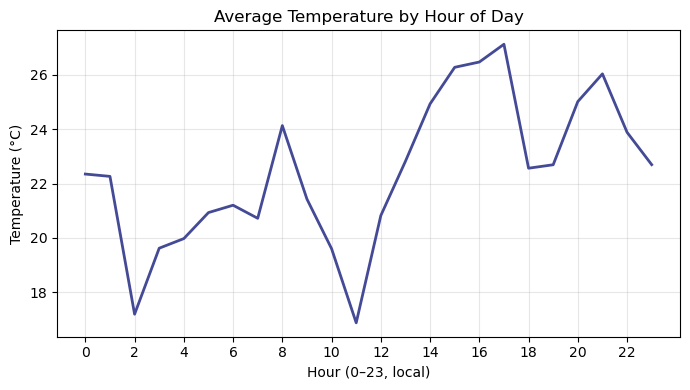

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

d = df[["last_updated", "temperature_celsius"]].dropna().copy()
d["hour"] = d["last_updated"].dt.hour
agg = d.groupby("hour")["temperature_celsius"].mean()

plt.figure(figsize=(7,4))
plt.plot(agg.index, agg.values, linewidth=2, color="#444a96")  
plt.title("Average Temperature by Hour of Day")
plt.xlabel("Hour (0–23, local)")
plt.ylabel("Temperature (°C)")
plt.xticks(range(0,24,2))
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


1. **Reason**:
A line chart was chosen because the time variable (hours 0–23) is continuous and is easier to read in the form of a trend line compared to a bar chart. This visualization makes it easier to identify the rise and fall pattern of temperature throughout the day.
2. **Daily Temperature Pattern**:
The chart shows that average temperature tends to be lower in the early morning hours (around 2–6 a.m.), then gradually increases until it peaks in the late afternoon (around 4–5 p.m.). After that, the temperature decreases again toward the evening.
3. **Peaks and Valleys**:
    - The minimum occurs in the early morning (around 2–3 a.m. or 11 a.m.), with average temperatures close to 17–18°C.
    - The maximum occurs in the late afternoon (around 4–5 p.m.), with temperatures exceeding 27°C.
4. **Data Implication**:
This pattern aligns with the natural cycle of Earth’s heating by the sun. Temperatures rise after sunrise, reach their peak in the afternoon, and then decrease after sunset. However, small fluctuations at certain hours may be influenced by differences in location within the global dataset.
5. **Key Insight**:
    - Confirms a consistent daily rhythm of temperature.
    - The lowest temperatures occur in the early morning, rising after sunrise and peaking in the afternoon before falling again in the evening. This reflects the natural daily cycle of atmospheric heating.

## Line Chart Decoration – Mean ± 95% CI of Temperature / Hour (last_updated, temperature_celsius)

In [22]:
# Prepare data: local hour & country
d = df[["last_updated", "temperature_celsius", "country"]].dropna().copy()
d["hour"] = d["last_updated"].dt.hour

# Aggregate by (country, hour): mean ± 95% CI
g = d.groupby(["country", "hour"])["temperature_celsius"]
agg = g.agg(["mean", "std", "count"]).reset_index()
agg["se"] = agg["std"] / np.sqrt(agg["count"].replace(0, np.nan))
agg["ci95"] = 1.96 * agg["se"]
agg["lo"] = agg["mean"] - agg["ci95"]
agg["hi"] = agg["mean"] + agg["ci95"]

# Global aggregation (All Countries)
G = d.groupby("hour")["temperature_celsius"].agg(["mean", "std", "count"]).reset_index()
G["se"] = G["std"] / np.sqrt(G["count"].replace(0, np.nan))
G["ci95"] = 1.96 * G["se"]
G["lo"] = G["mean"] - G["ci95"]
G["hi"] = G["mean"] + G["ci95"]
G["country"] = "All Countries"

# Combine country-specific & global data
agg_all = pd.concat([
    agg[["country","hour","mean","lo","hi"]],
    G[["country","hour","mean","lo","hi"]]
], ignore_index=True)

# Sort by country & hour
agg_all = agg_all.sort_values(["country", "hour"])

# Build figure with one set of traces per country (CI band + mean line) 
fig = go.Figure()
countries = agg_all["country"].unique().tolist()

def add_country_traces(country, visible):
    dd = agg_all[agg_all["country"] == country]
    x = dd["hour"].values
    # Band CI (lo, hi)
    fig.add_trace(go.Scatter(
        x=x, y=dd["lo"], mode="lines", line=dict(width=0),
        name=f"{country} • 95% CI (low)", showlegend=False, visible=visible
    ))
    fig.add_trace(go.Scatter(
        x=x, y=dd["hi"], mode="lines", line=dict(width=0),
        fill="tonexty", fillcolor="rgba(68,74,150,0.15)",
        name=f"{country} • 95% CI", visible=visible,
        hoverinfo="skip", showlegend=True
    ))
    # Mean line
    fig.add_trace(go.Scatter(
        x=x, y=dd["mean"], mode="lines+markers",
        line=dict(width=2, color="#444a96"),
        marker=dict(size=6, color="#444a96"),
        name=f"{country} • Mean", visible=visible
    ))

# Add traces for each country, only "All Countries" visible by default
for c in countries:
    add_country_traces(c, visible=(c == "All Countries"))

# Dropdown buttons to select country
# 3 trace per country (lo, hi+fill, mean)
traces_per_country = 3
buttons = []
for i, c in enumerate(countries):
    vis = [False] * (len(countries) * traces_per_country)
    start = i * traces_per_country
    vis[start:start+traces_per_country] = [True, True, True]
    buttons.append(dict(
        label=c,
        method="update",
        args=[{"visible": vis},
              {"title": f"Average Temperature by Hour (Mean ± 95% CI) — {c}"}]
    ))

fig.update_layout(
    updatemenus=[dict(
        type="dropdown", x=0.01, y=0.99, xanchor="left", yanchor="top",
        buttons=buttons
    )],
    title="Average Temperature by Hour (Mean ± 95% CI) — All Countries",
    xaxis_title="Hour (0–23, local)",
    yaxis_title="Temperature (°C)",
    hovermode="x unified",
    template="plotly_white",
    margin=dict(l=40, r=20, t=60, b=40)
)

fig.show()


C:\Users\User\AppData\Local\Temp\ipykernel_20184\3467451551.py:6: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



A simple line chart shows the daily temperature pattern in a concise and easy-to-read way, but it does not provide information about data variation across locations. In contrast, a decorated line chart with a 95% confidence interval and annotations for minimum and maximum points is more informative because it not only highlights the average trend but also shows the consistency and extremes within the data. 

With the addition of a country dropdown using Plotly, it becomes possible to view either the global aggregation or focus on a specific country without creating separate charts. The mean ± 95% confidence interval per hour not only displays the average trend but also the uncertainty or variation at each hour for each country, which is important since the number and distribution of observations differ across countries. Therefore, the simple version is suitable for an overview, while the decorated version is more appropriate for in-depth analysis.

## Line Plot (Binned Means) – Cloud vs UV (cloud, uv_index)

C:\Users\User\AppData\Local\Temp\ipykernel_20184\2918713563.py:6: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



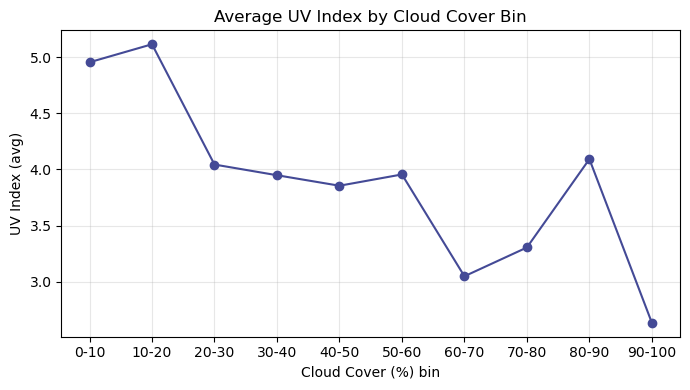

In [32]:
d = df[["cloud", "uv_index"]].dropna().copy()
bins = np.arange(0, 110, 10)
labels = [f"{b}-{b+10}" for b in bins[:-1]]
d["cloud_bin"] = pd.cut(d["cloud"], bins=bins, labels=labels, include_lowest=True, right=False)

uv_mean = d.groupby("cloud_bin")["uv_index"].mean().reindex(labels)

plt.figure(figsize=(7,4))
plt.plot(uv_mean.index.astype(str), uv_mean.values, marker="o", color="#444a96")
plt.title("Average UV Index by Cloud Cover Bin")
plt.xlabel("Cloud Cover (%) bin"); plt.ylabel("UV Index (avg)")
plt.grid(alpha=0.3); plt.tight_layout(); plt.show()


1. **Reason**:
A line plot with averages per bin was chosen to examine the simple functional relationship between cloud cover levels and UV intensity. Binning (0–10%, 10–20%, …, 90–100%) helps organize the highly variable distribution of data so that the trend pattern becomes easier to read.
2. **Relationship Pattern**:
It can be seen that at low cloud cover (0–20%), the UV index values are relatively high (around 5). As cloud cover increases up to 60–70%, the UV index drops sharply to below 3, showing the protective effect of clouds against UV radiation.
3. **Anomalies or Fluctuations**:
Although the overall trend is downward, there are some increases again in the 70–80% and 80–90% bins. This may be influenced by thin or broken cloud phenomena that still allow much of the UV radiation to penetrate the atmosphere, or by data variation across different locations.
4. **Key Insight**:
    - Confirms a negative correlation between cloud cover and UV intensity. 
    - More cloud cover there is, the less UV radiation reaches the surface. 
    - Fluctuations at higher bins indicate that the effect of clouds is not always linear and is influenced by local atmospheric conditions.

## Wind Rose (Polar Bar) – Wind Direction & Speed (wind_degree, wind_kph)

C:\Users\User\AppData\Local\Temp\ipykernel_20184\3331594799.py:6: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



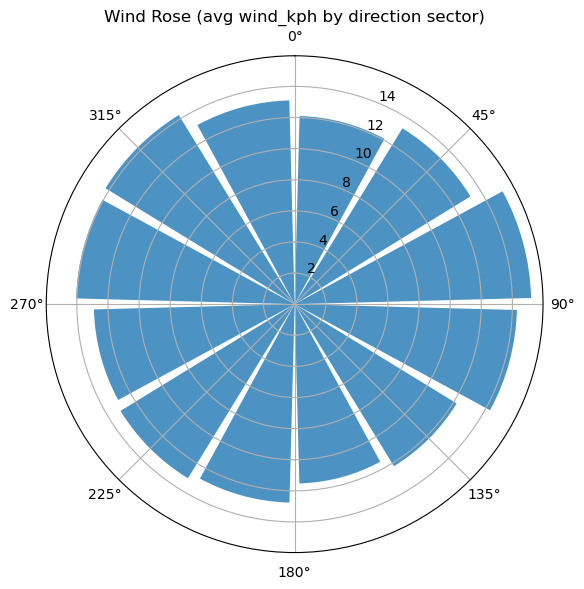

In [24]:
w = df[["wind_degree", "wind_kph"]].dropna().copy()
w = w[(w["wind_degree"] >= 0) & (w["wind_degree"] < 360)]

bins = np.arange(0, 361, 30)  # 12 sectors of 30°
w["dir_bin"] = pd.cut(w["wind_degree"], bins=bins, right=False, include_lowest=True)
avg_speed = w.groupby("dir_bin")["wind_kph"].mean()

bin_centers_deg = np.arange(15, 360, 30)  # center of each sector
bin_centers = np.deg2rad(bin_centers_deg)
radii = avg_speed.values

plt.figure(figsize=(6,6))
ax = plt.subplot(111, polar=True)
ax.bar(bin_centers, radii, width=np.deg2rad(30*0.9), bottom=0.0, alpha=0.8)
ax.set_theta_zero_location("N")
ax.set_theta_direction(-1)
ax.set_title("Wind Rose (avg wind_kph by direction sector)")
plt.tight_layout(); plt.show()

1. **Reason**:
A wind rose was chosen because it is the standard visualization for showing both wind direction and wind intensity simultaneously. 
2. **Wind Direction Distribution**:
The diagram shows that wind blows from various directions with a relatively even distribution. No single directional sector is overwhelmingly dominant, although the east (90°) and west (270°) sectors appear slightly stronger.
3. **Average Speed**:
The average wind speed in each sector falls within the range of 10 to 15 kph, with the highest peaks approaching 15 kph. This indicates that winds in this dataset are generally of moderate speed, without significant differences between directions.
4. **Data Implication**:
This even distribution may reflect the global nature of the data, which comes from various locations with different wind patterns, so dominant directions may be “blurred” in aggregation. For local studies, wind direction patterns are usually clearer, such as monsoons or land–sea breezes.
5. **Key Insight**:
    - Confirms that the dataset represents global winds with relatively balanced directions and moderate average speeds.
    - While effective for providing an overview, more detailed analysis should focus on subsets by region or season to make dominant patterns more apparent.

## Heatmap Corelation – All Numeric Variables

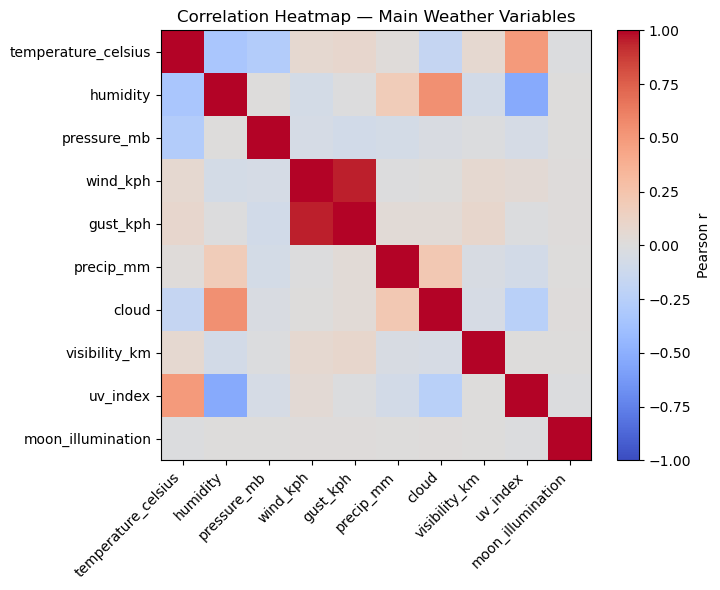

In [25]:
num_cols = [
    c for c in [
        "temperature_celsius","humidity","pressure_mb","wind_kph","gust_kph",
        "precip_mm","cloud","visibility_km","uv_index","moon_illumination"
    ] if c in df.columns
]
corr = df[num_cols].corr(method="pearson")

plt.figure(figsize=(8,6))
im = plt.imshow(corr, cmap="coolwarm", vmin=-1, vmax=1)
plt.colorbar(im, fraction=0.046, pad=0.04, label="Pearson r")
plt.xticks(range(len(num_cols)), num_cols, rotation=45, ha="right")
plt.yticks(range(len(num_cols)), num_cols)
plt.title("Correlation Heatmap — Main Weather Variables")
plt.tight_layout(); plt.show()

1. **Reason**:
A heatmap was chosen because it can comprehensively show linear relationships among numerical variables. With a color scale where blue represents negative and red represents positive, readers can quickly identify pairs of variables that are strongly or weakly correlated.
2. **Strong Positive Correlation**:
Wind_kph and Gust_kph show an almost perfect correlation, close to +1, which is logical because gusts are usually extreme forms of average wind speed. Cloud and Humidity also display a fairly strong positive correlation, confirming that high humidity is often associated with greater cloud cover.
3. **Important Negative Correlation**:
Temperature and Humidity are negatively correlated, indicating that when temperature rises, relative humidity tends to decrease, consistent with the physical properties of air. Temperature and Cloud also show a slight negative correlation, meaning cloudy skies are more often linked with lower temperatures.
4. **Weak or Insignificant Correlation**:
Most other pairs of variables, such as precip_mm with other variables or uv_index with moon_illumination, show weak correlations, suggesting no consistent linear relationship in this global dataset.
5. **Key Insight**:
    - Highlights common meteorological relationships. 
    - Strong winds are closely related to gusts, humidity is associated with cloud cover, and temperature is inversely related to humidity. 
    - Most variables appear to be independent, reflecting the complexity of global climate factors that cannot be explained solely through simple linear relationships.